In [1]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.svm import SVR

## 3.) Support Vector Regression

In [2]:
""" Helper function to perform data standardization """
def data_std(X, mean, std):
    return (X - mean)/std

## Part a.)

In [3]:
""" Load and parse data """
data = np.genfromtxt("train.txt", delimiter="\t")
train_X = data[:, 0:2]
train_y = data[:, 2]
data = np.genfromtxt("test.txt", delimiter="\t")
test_X = data[:, 0:2]
test_y = data[:, 2]

""" Establish standardized data """
# Mean of training features: (# of features, )
mean = np.mean(train_X, axis = 0)
# Standard deviation of training features: (# of features, )
std = np.std(train_X, axis = 0)

train_X_st = data_std(train_X, mean, std)
test_X_st = data_std(test_X, mean, std)

In [4]:
""" Sklearn SVR model """
# Default: C = 1, Kernel = rbf
model = SVR(epsilon=0.0001).fit(train_X_st, train_y)
pred = model.predict(test_X_st)

""" Compute RMSE """
RMSE = np.sqrt(np.mean(np.power(test_y - pred, 2)))
print("RMSE = {}".format(RMSE))

RMSE = 24.033860070431174


## Part b.)

Same as part a.), but loop through permutations of $C$ and $\epsilon$

In [5]:
Cs = [0.01, 10, 100]
eps = [0.0001, 0.01, 1]
for i in range(len(Cs)):
    for j in range(len(eps)):
        model = SVR(C=Cs[i], epsilon=eps[j]).fit(train_X_st, train_y)
        pred = model.predict(test_X_st)
        RMSE = np.sqrt(np.mean(np.power(test_y - pred, 2)))
        print("C = {}, epsilon = {} -> RMSE = {}".format(Cs[i], eps[j], RMSE))

C = 0.01, epsilon = 0.0001 -> RMSE = 49.86230821904665
C = 0.01, epsilon = 0.01 -> RMSE = 49.86230821904665
C = 0.01, epsilon = 1 -> RMSE = 49.719198470155014
C = 10, epsilon = 0.0001 -> RMSE = 7.206613901052269
C = 10, epsilon = 0.01 -> RMSE = 7.2030835074726145
C = 10, epsilon = 1 -> RMSE = 7.195908569734601
C = 100, epsilon = 0.0001 -> RMSE = 4.356151814584229
C = 100, epsilon = 0.01 -> RMSE = 4.354976661414509
C = 100, epsilon = 1 -> RMSE = 4.189717810970863


The higher penalty strengths $C$ are much more effective in reducing the classification error, however, only to a certain value before the model is overfitted. 
While keeping $C$ constant, it seems that a larger epsilon value yields less RMSE.

## Part c.)

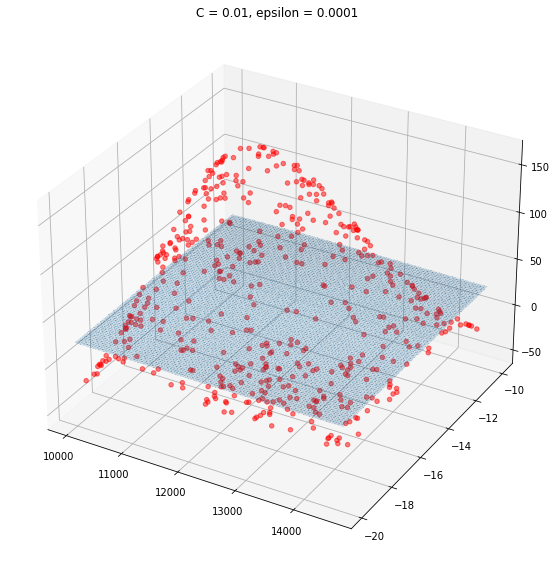

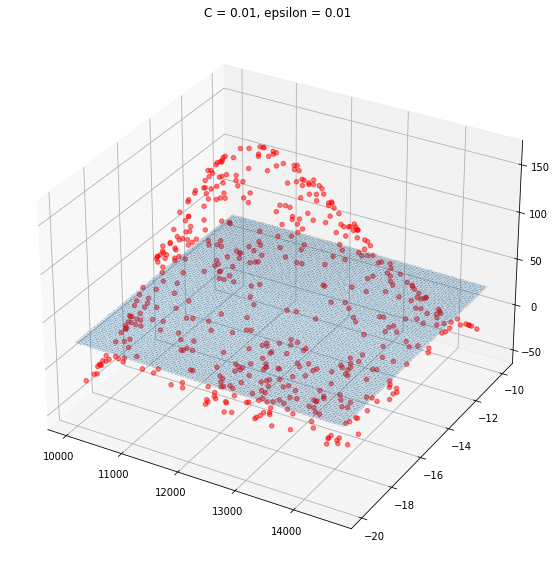

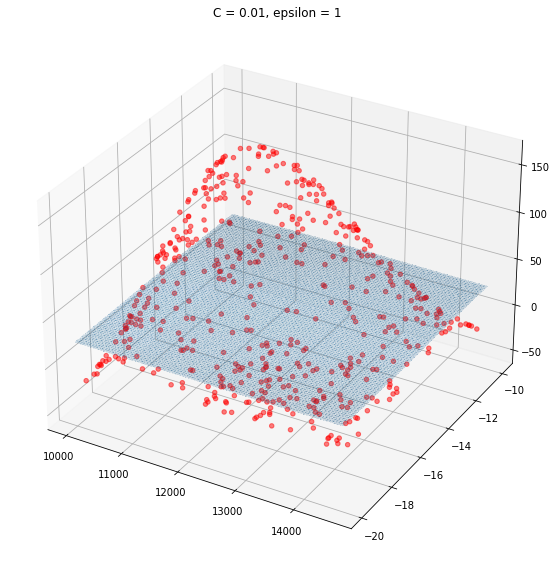

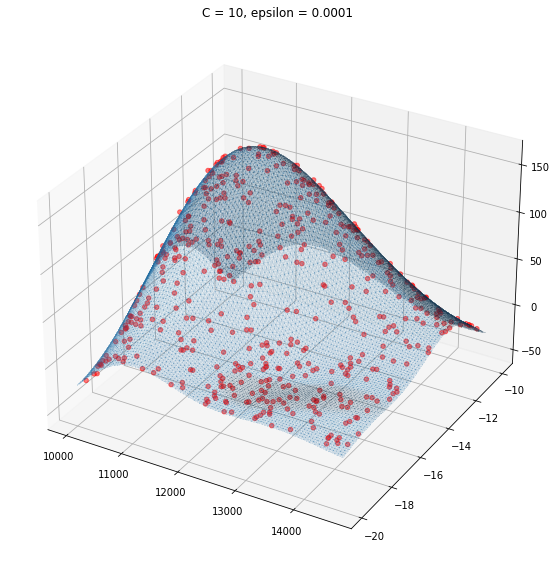

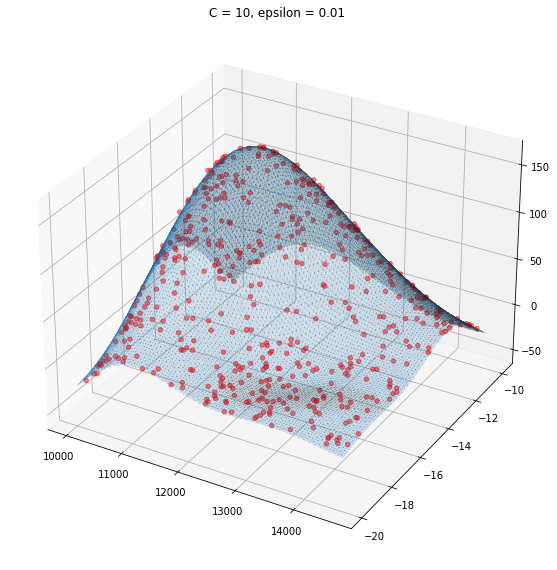

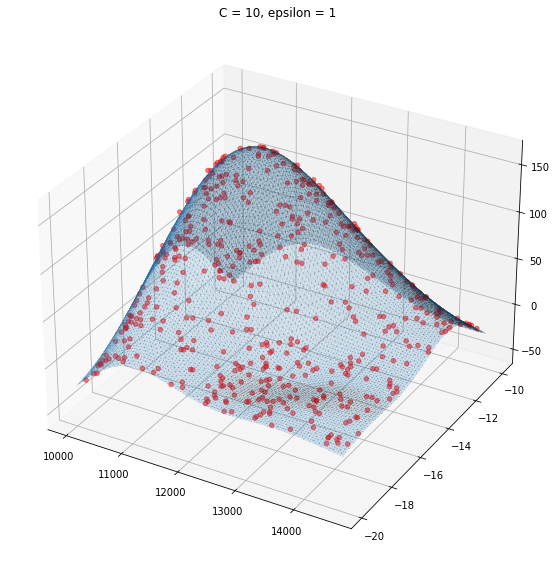

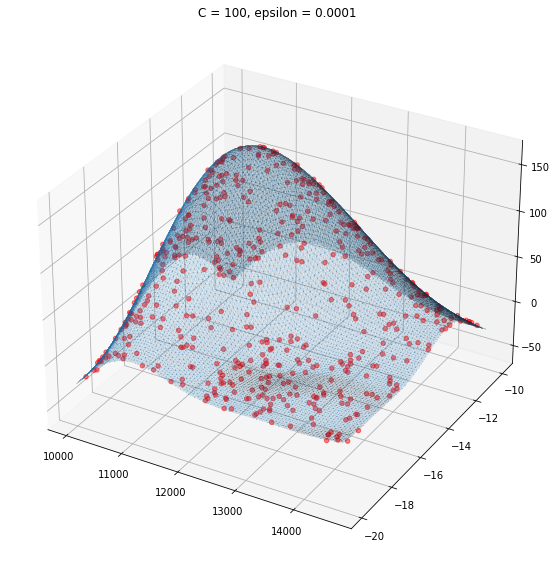

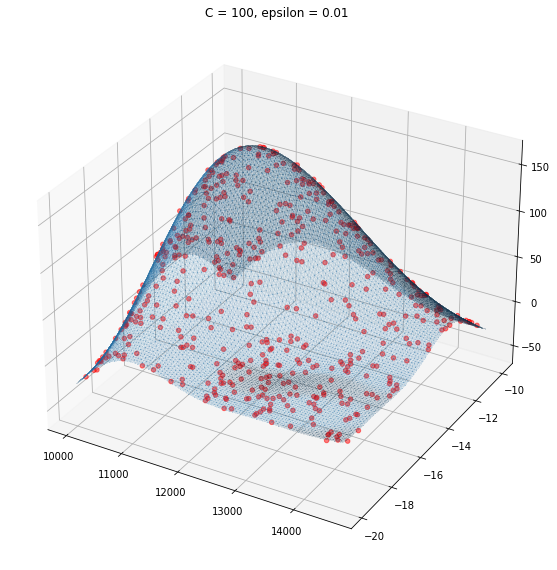

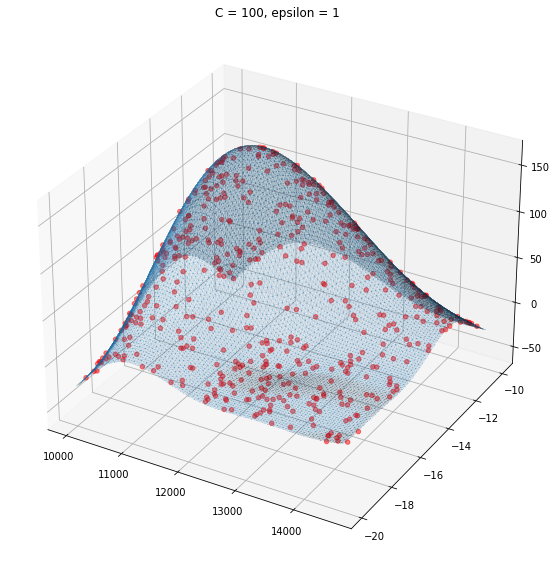

In [6]:
""" Create feature mesh and standardize the feature mesh """
xx, yy = np.meshgrid(np.linspace(test_X[:, 0].min(), test_X[:, 0].max(), 100), np.linspace(test_X[:, 1].min(), test_X[:, 1].max(), 100))
feat_mesh = data_std(np.c_[xx.ravel(), yy.ravel()], mean, std)

""" Same as part b.), but loop through permutations of C and epsilon """
Cs = [0.01, 10, 100]
eps = [0.0001, 0.01, 1]
count = 0
for i in range(len(Cs)):
    for j in range(len(eps)):
        model = SVR(C=Cs[i], epsilon=eps[j]).fit(train_X_st, train_y)
        pred = model.predict(feat_mesh)

        """ Plot each regression model as a surface """
        fig = plt.figure(count, figsize = (7.5, 7.5))
        ax = Axes3D(fig)
        ax.plot_trisurf(xx.flatten(), yy.flatten(), pred, linewidth=0, antialiased=False, alpha = 0.1)
        ax.scatter3D(test_X[:, 0], test_X[:, 1], test_y, c='r', alpha=0.5)
        plt.title("C = {}, epsilon = {}".format(Cs[i], eps[j]))
        plt.show()
        count += 1